In [1]:
import pandas as pd
import numpy as np
from neuralprophet import NeuralProphet
from fbprophet import Prophet
from fbprophet.plot import plot_plotly, plot_components_plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as py
py.init_notebook_mode(connected=True)
from plotly.offline import init_notebook_mode, iplot

# EJERCICIO DE ESTUDIO DE LA TEMPERATURA

## Dataset de la temperatura en varias ciudades

In [2]:
df_tiempo=pd.read_csv('/Users/ismaelgarciainigo/Downloads/temperature.csv')

In [3]:
df_tiempo

,datetime,Vancouver,Portland,San Francisco,Seattle,Los Angeles,San Diego,Las Vegas,Phoenix,Albuquerque,...,Philadelphia,New York,Montreal,Boston,Beersheba,Tel Aviv District,Eilat,Haifa,Nahariyya,Jerusalem
0,2012-10-01 12:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,309.100000,NaN,NaN,NaN
1,2012-10-01 13:00:00,284.630000,282.080000,289.480000,281.800000,291.870000,291.530000,293.410000,296.600000,285.120000,...,285.630000,288.220000,285.830000,287.170000,307.590000,305.470000,310.580000,304.4,304.4,303.5
2,2012-10-01 14:00:00,284.629041,282.083252,289.474993,281.797217,291.868186,291.533501,293.403141,296.608509,285.154558,...,285.663208,288.247676,285.834650,287.186092,307.590000,304.310000,310.495769,304.4,304.4,303.5
3,2012-10-01 15:00:00,284.626998,282.091866,289.460618,281.789833,291.862844,291.543355,293.392177,296.631487,285.233952,...,285.756824,288.326940,285.847790,287.231672,307.391513,304.281841,310.411538,304.4,304.4,303.5
4,2012-10-01 16:00:00,284.624955,282.100481,289.446243,281.782449,291.857503,291.553209,293.381213,296.654466,285.313345,...,285.850440,288.406203,285.860929,287.277251,307.145200,304.238015,310.327308,304.4,304.4,303.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45248,2017-11-29 20:00:00,NaN,282.000000,NaN,280.820000,293.550000,292.150000,289.540000,294.710000,285.720000,...,290.240000,NaN,275.130000,288.080000,NaN,NaN,NaN,NaN,NaN,NaN
45249,2017-11-29 21:00:00,NaN,282.890000,NaN,281.650000,295.680000,292.740000,290.610000,295.590000,286.450000,...,289.240000,NaN,274.130000,286.020000,NaN,NaN,NaN,NaN,NaN,NaN
45250,2017-11-29 22:00:00,NaN,283.390000,NaN,282.750000,295.960000,292.580000,291.340000,296.250000,286.440000,...,286.780000,NaN,273.480000,283.940000,NaN,NaN,NaN,NaN,NaN,NaN
45251,2017-11-29 23:00:00,NaN,283.020000,NaN,282.960000,295.650000,292.610000,292.150000,297.150000,286.140000,...,284.570000,NaN,272.480000,282.170000,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df_tiempo.isnull().sum()

datetime               0
Vancouver            795
Portland               1
San Francisco        793
Seattle                3
Los Angeles            3
San Diego              1
Las Vegas              1
Phoenix                3
Albuquerque            1
Denver                 1
San Antonio            1
Dallas                 4
Houston                3
Kansas City            1
Minneapolis           13
Saint Louis            1
Chicago                3
Nashville              2
Indianapolis           7
Atlanta                6
Detroit                1
Jacksonville           1
Charlotte              3
Miami                805
Pittsburgh             3
Toronto                1
Philadelphia           3
New York             793
Montreal               3
Boston                 3
Beersheba            798
Tel Aviv District    793
Eilat                792
Haifa                798
Nahariyya            797
Jerusalem            793
dtype: int64

### Seleccionamos la ciudad de los Angeles para el estudio

In [5]:
df_temp=df_tiempo.loc[:,['datetime','Los Angeles']]
df_temp

,datetime,Los Angeles
0,2012-10-01 12:00:00,NaN
1,2012-10-01 13:00:00,291.870000
2,2012-10-01 14:00:00,291.868186
3,2012-10-01 15:00:00,291.862844
4,2012-10-01 16:00:00,291.857503
...,...,...
45248,2017-11-29 20:00:00,293.550000
45249,2017-11-29 21:00:00,295.680000
45250,2017-11-29 22:00:00,295.960000
45251,2017-11-29 23:00:00,295.650000


### Elaboramos los ajustes en el dataframe para el estudio con los algoritmos prophet

In [6]:
df_temp.fillna(df_temp['Los Angeles'].mode()[0],inplace=True)

In [7]:
df_temp.rename(columns={'datetime':'ds','Los Angeles':'y'},inplace=True)

In [8]:
df_temp

,ds,y
0,2012-10-01 12:00:00,301.113000
1,2012-10-01 13:00:00,291.870000
2,2012-10-01 14:00:00,291.868186
3,2012-10-01 15:00:00,291.862844
4,2012-10-01 16:00:00,291.857503
...,...,...
45248,2017-11-29 20:00:00,293.550000
45249,2017-11-29 21:00:00,295.680000
45250,2017-11-29 22:00:00,295.960000
45251,2017-11-29 23:00:00,295.650000


### Visualización del dataframe, a simple vista se ve que es una serie temporal con estacionalidad

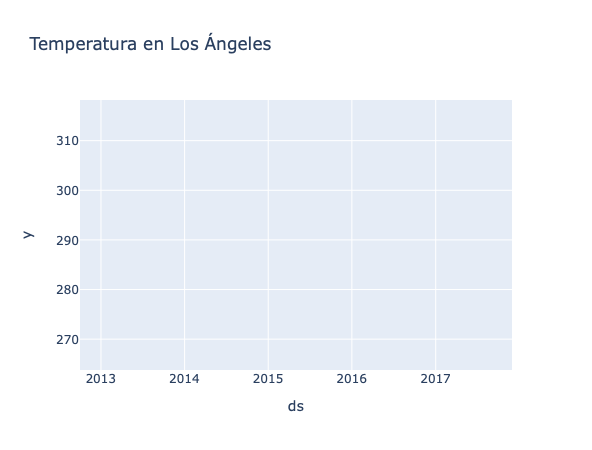

In [9]:
fig = px.line(df_temp, x="ds", y="y",title='Temperatura en Los Ángeles')
fig.show()

### Separamos el dataframe en entrenamiento y prueba

In [10]:
test_length=df_temp[df_temp['ds']=='2016-11-30 12:00:00'].index[0]
df_train=df_temp.iloc[:test_length]
df_test=df_temp.iloc[test_length:]

In [11]:
df_train

,ds,y
0,2012-10-01 12:00:00,301.113000
1,2012-10-01 13:00:00,291.870000
2,2012-10-01 14:00:00,291.868186
3,2012-10-01 15:00:00,291.862844
4,2012-10-01 16:00:00,291.857503
...,...,...
36499,2016-11-30 07:00:00,283.820000
36500,2016-11-30 08:00:00,283.630000
36501,2016-11-30 09:00:00,282.970000
36502,2016-11-30 10:00:00,282.300000


In [12]:
df_test

,ds,y
36504,2016-11-30 12:00:00,281.22
36505,2016-11-30 13:00:00,280.78
36506,2016-11-30 14:00:00,280.39
36507,2016-11-30 15:00:00,280.29
36508,2016-11-30 16:00:00,283.14
...,...,...
45248,2017-11-29 20:00:00,293.55
45249,2017-11-29 21:00:00,295.68
45250,2017-11-29 22:00:00,295.96
45251,2017-11-29 23:00:00,295.65


### Construimos el modelo.
Tengan en cuenta que es la medición de la temperatura cada hora entre 2012 y 2017, es por ello que tenemos que cambiar la frecuencia del dataframe de predicción

In [13]:
prophet_model=Prophet()
prophet_model.fit(df_train)
future_df=prophet_model.make_future_dataframe(periods=len(df_test), freq='H')
forecast=prophet_model.predict(future_df)

INFO:numexpr.utils:NumExpr defaulting to 8 threads.


### Dataframe de predicción

In [14]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2012-10-01 12:00:00,295.413623,287.130679,295.417394,295.413623,295.413623,-4.140343,-4.140343,-4.140343,-4.681172,...,0.034081,0.034081,0.034081,0.506748,0.506748,0.506748,0.0,0.0,0.0,291.273279
1,2012-10-01 13:00:00,295.412356,287.087693,295.661995,295.412356,295.412356,-4.087641,-4.087641,-4.087641,-4.606374,...,0.020239,0.020239,0.020239,0.498494,0.498494,0.498494,0.0,0.0,0.0,291.324715
2,2012-10-01 14:00:00,295.411090,287.748565,296.128053,295.411090,295.411090,-3.590054,-3.590054,-3.590054,-4.086429,...,0.006138,0.006138,0.006138,0.490237,0.490237,0.490237,0.0,0.0,0.0,291.821036
3,2012-10-01 15:00:00,295.409824,288.716025,296.931272,295.409824,295.409824,-2.501683,-2.501683,-2.501683,-2.975552,...,-0.008108,-0.008108,-0.008108,0.481977,0.481977,0.481977,0.0,0.0,0.0,292.908141
4,2012-10-01 16:00:00,295.408558,290.224903,298.619943,295.408558,295.408558,-0.855401,-0.855401,-0.855401,-1.306730,...,-0.022386,-0.022386,-0.022386,0.473714,0.473714,0.473714,0.0,0.0,0.0,294.553157
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45248,2017-11-29 20:00:00,298.069587,234.648380,365.950081,233.823377,363.960454,0.727021,0.727021,0.727021,5.280562,...,-0.022968,-0.022968,-0.022968,-4.530573,-4.530573,-4.530573,0.0,0.0,0.0,298.796607
45249,2017-11-29 21:00:00,298.070106,233.762213,366.202320,233.814019,363.960124,1.304473,1.304473,1.304473,5.859746,...,-0.023189,-0.023189,-0.023189,-4.532084,-4.532084,-4.532084,0.0,0.0,0.0,299.374579
45250,2017-11-29 22:00:00,298.070625,234.641189,366.018558,233.804660,363.959794,1.410363,1.410363,1.410363,5.967564,...,-0.023605,-0.023605,-0.023605,-4.533596,-4.533596,-4.533596,0.0,0.0,0.0,299.480988
45251,2017-11-29 23:00:00,298.071144,234.670351,364.676540,233.795302,363.959464,1.049052,1.049052,1.049052,5.608319,...,-0.024158,-0.024158,-0.024158,-4.535110,-4.535110,-4.535110,0.0,0.0,0.0,299.120196


### Visualización de la predicción y sus componentes

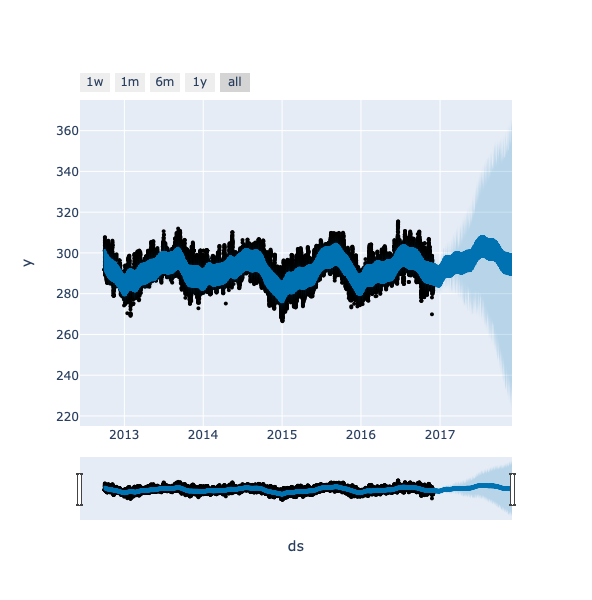

In [15]:
plot_plotly(prophet_model,forecast)

## Añadimos los resultados al dataframe de prueba

In [16]:
df_test['prophet'] = forecast.iloc[test_length:].loc[:,'yhat']



/Users/ismaelgarciainigo/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
df_test

,ds,y,prophet
36504,2016-11-30 12:00:00,281.22,284.250956
36505,2016-11-30 13:00:00,280.78,284.327743
36506,2016-11-30 14:00:00,280.39,284.849157
36507,2016-11-30 15:00:00,280.29,285.961001
36508,2016-11-30 16:00:00,283.14,287.630316
...,...,...,...
45248,2017-11-29 20:00:00,293.55,298.796607
45249,2017-11-29 21:00:00,295.68,299.374579
45250,2017-11-29 22:00:00,295.96,299.480988
45251,2017-11-29 23:00:00,295.65,299.120196


### Construimos el modelo Neural Prophet por analogía a los anteriores

In [18]:
model1 = NeuralProphet()
metrics = model1.fit(df_train, freq="H")
future = model1.make_future_dataframe(df_train, periods =len(df_test), 
                                                 n_historic_predictions=len(df_train))
forecast1 = model1.predict(future)

/Users/ismaelgarciainigo/opt/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1745: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO: nprophet.config - set_auto_batch_epoch: Auto-set batch_size to 128
INFO:nprophet.config:Auto-set batch_size to 128
INFO: nprophet.config - set_auto_batch_epoch: Auto-set epochs to 5
INFO:nprophet.config:Auto-set epochs to 5


INFO: nprophet - _lr_range_test: learning rate range test found optimal lr: 3.51E-01
INFO:nprophet:learning rate range test found optimal lr: 3.51E-01
Epoch[5/5]: 100%|██████████| 5/5 [00:04<00:00,  1.07it/s, SmoothL1Loss=0.00361, MAE=2.71, RegLoss=0]


In [19]:
forecast1

,ds,y,yhat1,residual1,trend,season_yearly,season_weekly,season_daily
0,2012-10-01 12:00:00,301.113000,289.867462,-11.245538,291.272095,3.372046,-0.093813,-4.682867
1,2012-10-01 13:00:00,291.870000,289.910187,-1.959813,291.271912,3.364100,-0.113168,-4.612657
2,2012-10-01 14:00:00,291.868186,290.430908,-1.437277,291.271729,3.356151,-0.132884,-4.064075
3,2012-10-01 15:00:00,291.862844,291.635498,-0.227346,291.271515,3.348197,-0.152813,-2.831411
4,2012-10-01 16:00:00,291.857503,293.247803,1.390299,291.271332,3.340240,-0.172800,-1.190990
...,...,...,...,...,...,...,...,...
45248,2017-11-29 20:00:00,NaN,292.563965,NaN,290.821930,-3.691487,-0.022527,5.456031
45249,2017-11-29 21:00:00,NaN,292.856354,NaN,290.821899,-3.697977,-0.018418,5.750853
45250,2017-11-29 22:00:00,NaN,292.705688,NaN,290.821838,-3.704469,-0.014722,5.603045
45251,2017-11-29 23:00:00,NaN,292.493164,NaN,290.821808,-3.710965,-0.011352,5.393677


### Añadimos los resultados al dataframe de testeo

In [20]:
df_test['Neural Prophet'] = forecast1.iloc[test_length:].loc[:,'yhat1']

/Users/ismaelgarciainigo/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
df_test

,ds,y,prophet,Neural Prophet
36504,2016-11-30 12:00:00,281.22,284.250956,282.580750
36505,2016-11-30 13:00:00,280.78,284.327743,282.653992
36506,2016-11-30 14:00:00,280.39,284.849157,283.204803
36507,2016-11-30 15:00:00,280.29,285.961001,284.438904
36508,2016-11-30 16:00:00,283.14,287.630316,286.079956
...,...,...,...,...
45248,2017-11-29 20:00:00,293.55,298.796607,292.563965
45249,2017-11-29 21:00:00,295.68,299.374579,292.856354
45250,2017-11-29 22:00:00,295.96,299.480988,292.705688
45251,2017-11-29 23:00:00,295.65,299.120196,292.493164


### Visualizamos los resultados obteniendo una impresión más exacta de cual es el potencial de estos algoritmos de cara al estudio de series temporales

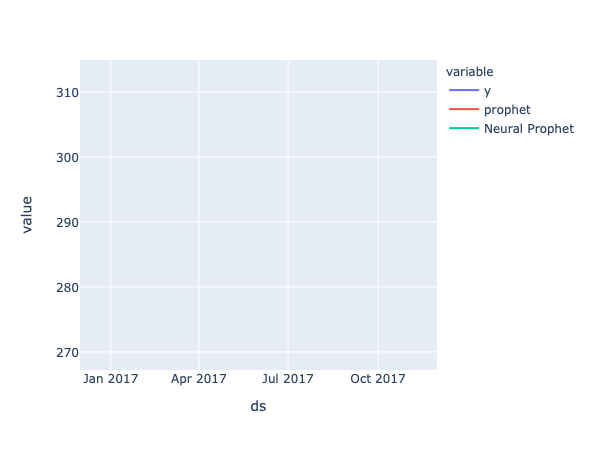

In [22]:
fig = px.line(df_test, x="ds", y=["y",'prophet','Neural Prophet'])
fig.show()